In [1]:
# importing all the libraries that will be required for this project
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import time

from all_methods import *
from skimage.feature import hog
from sklearn.preprocessing import StandardScaler
from sklearn.cross_validation import train_test_split
from sklearn.svm import LinearSVC

C:\Program Files\Anaconda3\lib\site-packages\sklearn\cross_validation.py:44: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
# Reading vehicle and non-vehicle images and gettig a sense of the data
all_cars = glob.glob('training_samples/vehicles/*/*.png')
all_non_cars = glob.glob('training_samples/non-vehicles/*/*.png')
print(len(all_cars), len(all_non_cars))

8792 8968


In [3]:
def plotThreeImagesInRow(image1, image2, image3, title1='image1', title2='image2', title3='image3'):
    plt.clf() # clear any previous saved data
    
    # creating layout to place three image sided-by-side with their respective title
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(image2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    ax3.imshow(image3, cmap='gray')
    ax3.set_title(title3, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def plotTwoImageInRow(image1, image2, title1='image1', title2='image2'):
    plt.clf()
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(image2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

In [4]:
# parameters for extracting the features
colorspace = 'YUV'
orient = 18
pix_per_cell = 8  # 8 gives out accuracy of 0.99 and 4 gives out accuracy of 1.0
cell_per_block =2
hog_channel = 'ALL'

In [5]:
# extracting features for cars and not-car images
t=time.time()
car_features = extract_features(all_cars, color_space=colorspace, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                        hog_channel=hog_channel)
notcar_features = extract_features(all_non_cars, color_space=colorspace, orient=orient, 
                        pix_per_cell=pix_per_cell, cell_per_block=cell_per_block, 
                        hog_channel=hog_channel)
t2 = time.time()

print(round(t2-t, 2), 'Seconds to extract HOG features...')
print(len(car_features), len(notcar_features))

70.6 Seconds to extract HOG features...
8792 8968


In [6]:
# Stacking all the feature vectors for cars and non-car images.
# And then normalizing them all so that one feature doesnt become dominant in classification
X = np.vstack((car_features, notcar_features)).astype(np.float64)
X_scalar = StandardScaler().fit(X)
scaled_X = X_scalar.transform(X)
print(scaled_X.shape)

# creating the labels vectors for cars and non-cars images
y = np.hstack((np.ones(len(car_features)), np.zeros(len(notcar_features))))

(17760, 13752)


In [7]:
# spliting the sample data into training and testing set
rand_state = np.random.randint(0, 100)
X_train, X_test, y_train, y_test = train_test_split(scaled_X, y, test_size=0.2, random_state=rand_state)

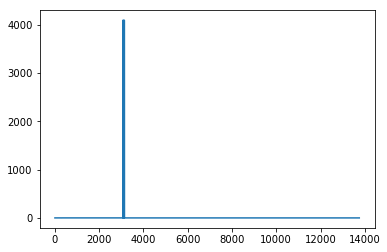

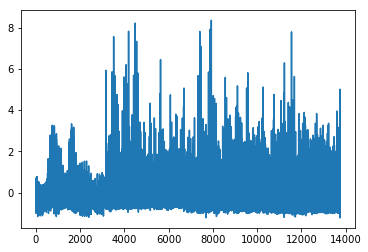

In [8]:
plt.plot(X[400])
plt.show()
plt.plot(scaled_X[400])
plt.show()

In [9]:
# creating a linear SVM classifier to test the pipeline
svc = LinearSVC()
t1 = time.time() # start time
svc.fit(X_train, y_train)
t2 = time.time() # end time

print(round(t2-t, 2), 'Seconds to train SVC...')

# Checking the score of the SVC
print('Test Accuracy of SVC = ', round(svc.score(X_test, y_test), 4))

# Checking the prediction time for a single sample of 10 elements
t=time.time()
print('My SVC predicts: ', svc.predict(X_test))
print('For these',len(X_test), 'labels: ', y_test)
t2 = time.time()
print(round(t2-t, 5), 'Seconds to predict', len(X_test),'labels with SVC')

87.37 Seconds to train SVC...
Test Accuracy of SVC =  0.9927
My SVC predicts:  [ 0.  1.  1. ...,  0.  0.  1.]
For these 3552 labels:  [ 0.  1.  1. ...,  0.  0.  1.]
0.07814 Seconds to predict 3552 labels with SVC


In [10]:
# testing the sliding windows search
test_image_1 = mpimg.imread('test_images\\test1.jpg')
test_image_1 = test_image_1.astype(np.float32)/255
print(test_image_1.shape)

(720, 1280, 3)


In [11]:
spatial_size = (32, 32) # Spatial binning dimensions
hist_bins = 32    # Number of histogram bins
spatial_feat = True # Spatial features on or off
hist_feat = True # Histogram features on or off
hog_feat = True # HOG features on or off
y_start_stop = [400, 700] # Min and max in y to search in slide_window()

draw_image = np.copy(test_image_1)
windows = slide_window(test_image_1, y_start_stop=y_start_stop, xy_window=(96,96), xy_overlap=(0.5, 0.5))
car_windows = search_windows(test_image_1, windows=windows, clf=svc, scaler=X_scalar, color_space=colorspace, spatial_size=spatial_size, hist_bins=hist_bins, 
                        orient=orient, pix_per_cell=pix_per_cell, 
                        cell_per_block=cell_per_block, 
                        hog_channel=hog_channel, spatial_feat=spatial_feat, 
                        hist_feat=hist_feat, hog_feat=hog_feat)

In [12]:
print('car windows found: ', len(car_windows))

car windows found:  4


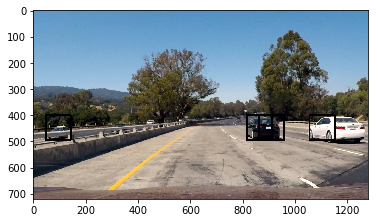

In [13]:
window_img = draw_boxes(test_image_1, car_windows, color=(0, 0, 255), thick=6)                    
plt.imshow(window_img)
plt.show()

In [14]:
def find_cars(img, ystart, ystop, scale, svc, X_scaler, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins):
    
    draw_img = np.copy(img)
    
    car_windows = []
    
    img_tosearch = img[ystart:ystop,:,:]
    ctrans_tosearch = convert_color(img_tosearch, conv='RGB2YCrCb')
    if scale != 1:
        imshape = ctrans_tosearch.shape
        ctrans_tosearch = cv2.resize(ctrans_tosearch, (np.int(imshape[1]/scale), np.int(imshape[0]/scale)))
        
    ch1 = ctrans_tosearch[:,:,0]
    ch2 = ctrans_tosearch[:,:,1]
    ch3 = ctrans_tosearch[:,:,2]

    # Define blocks and steps as above
    nxblocks = (ch1.shape[1] // pix_per_cell)-1
    nyblocks = (ch1.shape[0] // pix_per_cell)-1 
    nfeat_per_block = orient*cell_per_block**2
    # 64 was the orginal sampling rate, with 8 cells and 8 pix per cell
    window = 64
    nblocks_per_window = (window // pix_per_cell)-1 
    cells_per_step = 2  # Instead of overlap, define how many cells to step
    nxsteps = (nxblocks - nblocks_per_window) // cells_per_step
    nysteps = (nyblocks - nblocks_per_window) // cells_per_step
    
    # Compute individual channel HOG features for the entire image
    hog1 = get_hog_features(ch1, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog2 = get_hog_features(ch2, orient, pix_per_cell, cell_per_block, feature_vec=False)
    hog3 = get_hog_features(ch3, orient, pix_per_cell, cell_per_block, feature_vec=False)
    
    for xb in range(nxsteps):
        for yb in range(nysteps):
            ypos = yb*cells_per_step
            xpos = xb*cells_per_step
            # Extract HOG for this patch
            hog_feat1 = hog1[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat2 = hog2[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_feat3 = hog3[ypos:ypos+nblocks_per_window, xpos:xpos+nblocks_per_window].ravel() 
            hog_features = np.hstack((hog_feat1, hog_feat2, hog_feat3))
            

            xleft = xpos*pix_per_cell
            ytop = ypos*pix_per_cell

            # Extract the image patch
            subimg = cv2.resize(ctrans_tosearch[ytop:ytop+window, xleft:xleft+window], (64,64))
          
            # Get color features
            spatial_features = bin_spatial(subimg, size=spatial_size)
            hist_features = color_hist(subimg, nbins=hist_bins)

            # Scale features and make a prediction
            test_features = np.hstack((spatial_features, hist_features, hog_features))
            test_features = X_scaler.transform(test_features.reshape(1, -1))
            
            
            #test_features = X_scaler.transform(np.hstack((shape_feat, hist_feat)).reshape(1, -1))    
            test_prediction = svc.predict(test_features)
            
            if test_prediction == 1:
                xbox_left = np.int(xleft*scale)
                ytop_draw = np.int(ytop*scale)
                win_draw = np.int(window*scale)
                startx = xbox_left
                starty = ytop_draw+ystart
                endx = xbox_left+win_draw
                endy = ytop_draw+win_draw+ystart
                cv2.rectangle(draw_img,(startx, starty),(endx, endy),(0,0,255),6)
                car_windows.append(((startx, starty), (endx, endy)))
                
    return car_windows

In [15]:
ystart = 400
ystop = 656
scale = 2

car_winds = find_cars(test_image_1, ystart, ystop, scale, svc, X_scalar, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins)

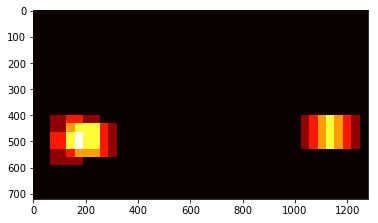

In [16]:
heat = np.zeros_like(test_image_1[:,:,0]).astype(np.float)

heat = add_heat(heat, car_winds)
plt.imshow(heat, cmap='hot')
plt.show()

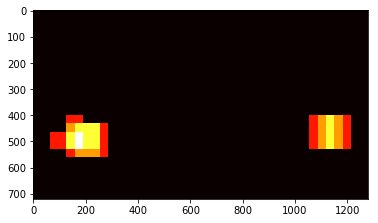

In [17]:
heat = apply_threshold(heat, 1)
heatmap = np.clip(heat, 0, 255)
plt.imshow(heatmap, cmap='hot')
plt.show()

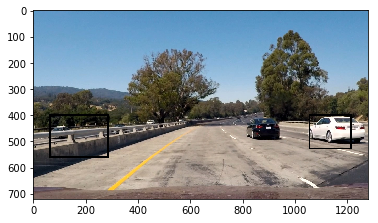

In [18]:
from scipy.ndimage.measurements import label
labels = label(heatmap)
draw_img = draw_labeled_bboxes(np.copy(test_image_1), labels)
plt.imshow(draw_img)
plt.show()

In [20]:
def plotThreeImagesInRow(image1, image2, image3, title1='image1', title2='image2', title3='image3'):
    plt.clf() # clear any previous saved data
    
    # creating layout to place three image sided-by-side with their respective title
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(image2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    ax3.imshow(image3, cmap='gray')
    ax3.set_title(title3, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

In [37]:
def find_cars_and_draw_box(img_frame):
    
    rectangles = []
    
    ystart = 400
    ystop = 650
    
    scale = 2
    
    rectangles.append(find_cars(img_frame, ystart, ystop, scale, svc, X_scalar, orient, pix_per_cell, cell_per_block, spatial_size, hist_bins))
    rectangles = [item for sub in rectangles for item in sub]
    print(len(rectangles))
    
    heat = np.zeros_like(img_frame[:,:,0]).astype(np.float)

    heat = add_heat(heat, rectangles)
    heat = apply_threshold(heat, 2)
    heatmap = np.clip(heat, 0, 255)
    
    labels = label(heatmap)
    print(len(labels))
    
    draw_img = draw_labeled_bboxes(np.copy(img_frame), labels)
    
    plotThreeImagesInRow(img_frame, heatmap, draw_img)
    
    return draw_img

108
2


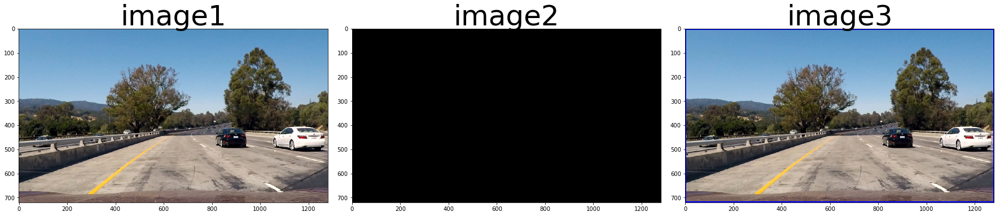

108
2


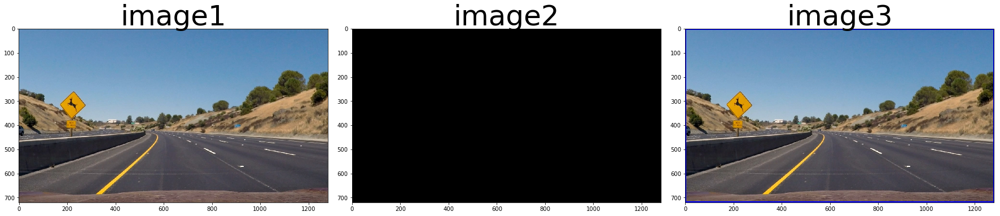

108
2


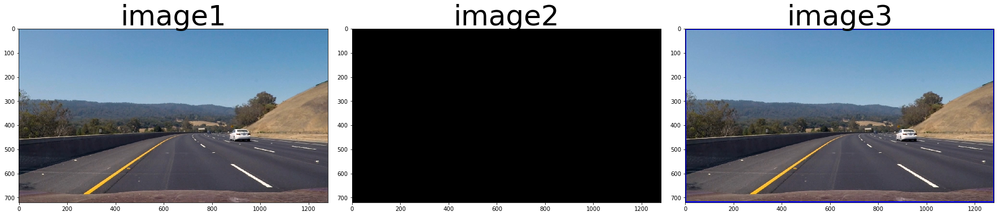

108
2


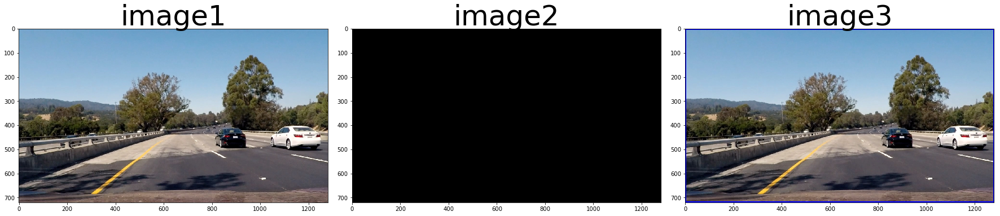

108
2


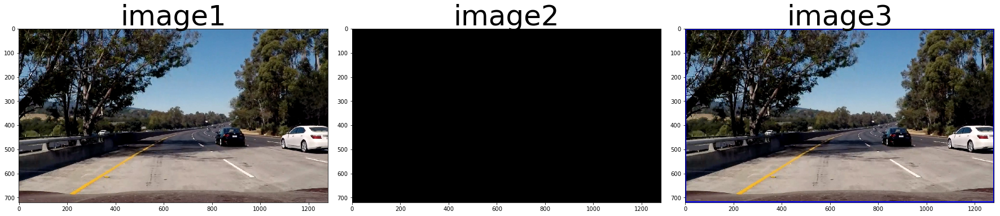

108
2


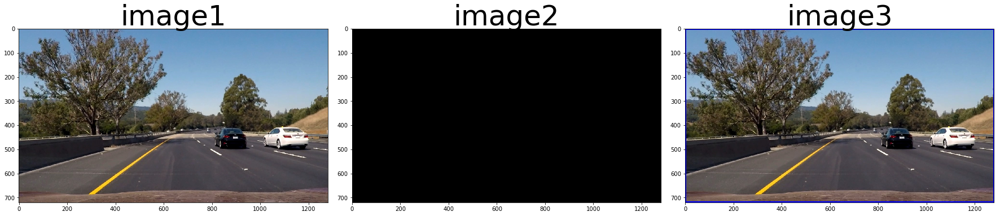

In [38]:
test_imgs = glob.glob('test_images/test*.jpg')
for file in test_imgs:
    img = mpimg.imread(file)
    find_cars_and_draw_box(img)

In [22]:
from IPython.display import HTML
from moviepy.editor import VideoFileClip

2


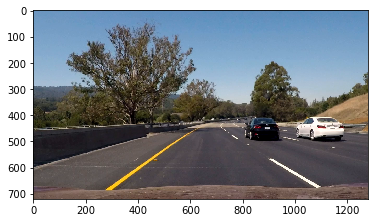

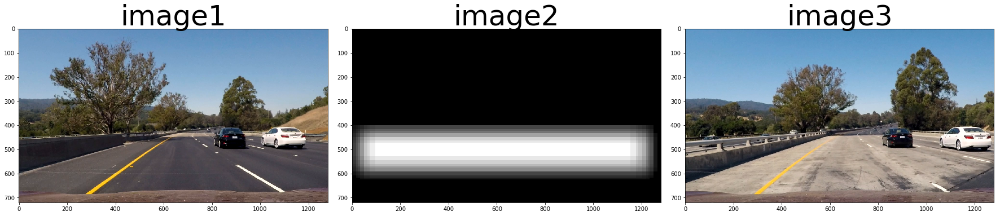

[MoviePy] >>>> Building video test_video_out.mp4
[MoviePy] Writing video test_video_out.mp4


  0%|                                                                                           | 0/39 [00:00<?, ?it/s]

2


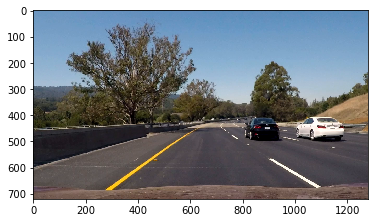

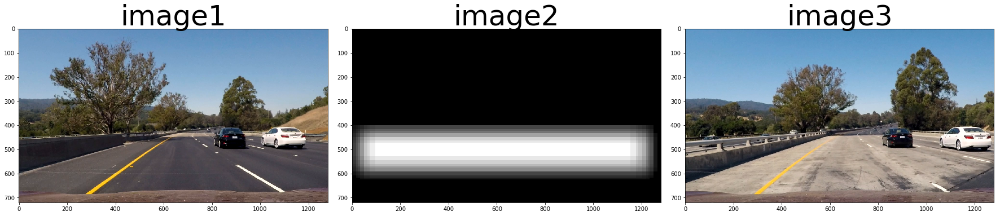

  3%|██▏                                                                                | 1/39 [00:02<01:30,  2.38s/it]

2


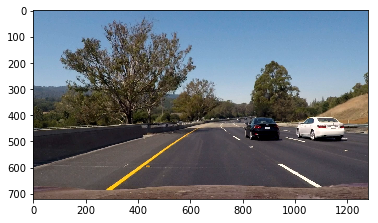

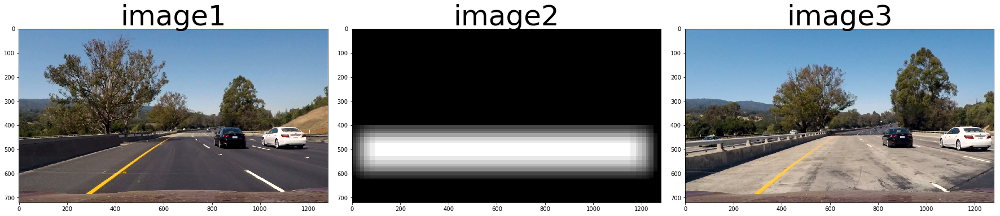

  5%|████▎                                                                              | 2/39 [00:04<01:30,  2.44s/it]

2


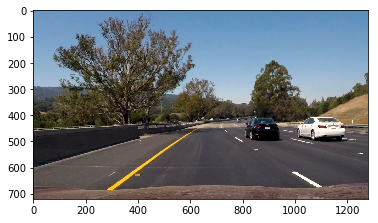

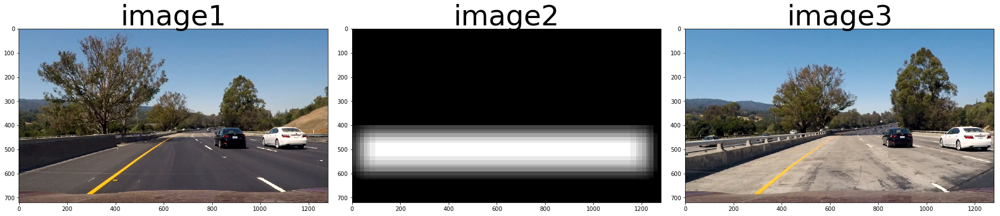

  8%|██████▍                                                                            | 3/39 [00:07<01:27,  2.43s/it]

2


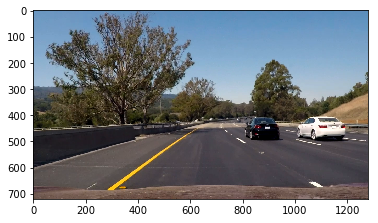

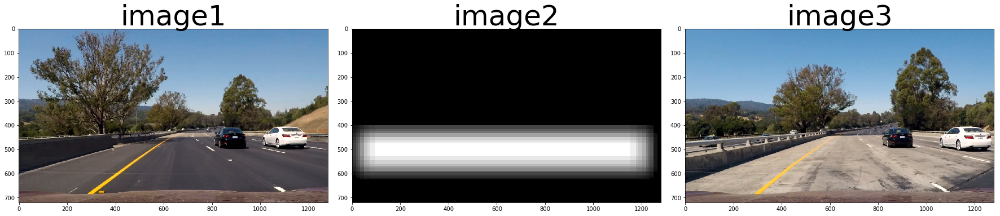

 10%|████████▌                                                                          | 4/39 [00:09<01:25,  2.44s/it]

2


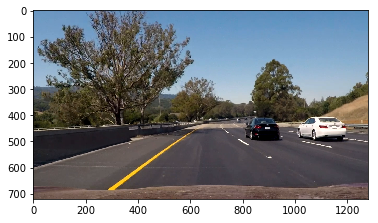

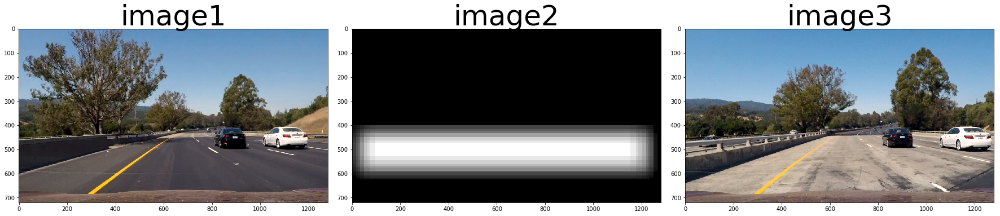

 13%|██████████▋                                                                        | 5/39 [00:12<01:22,  2.43s/it]

2


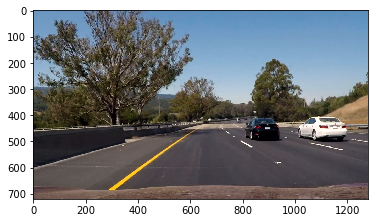

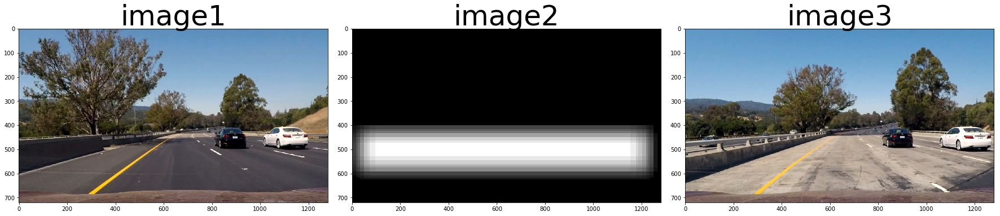

 15%|████████████▊                                                                      | 6/39 [00:14<01:19,  2.41s/it]

2


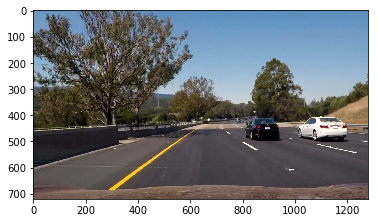

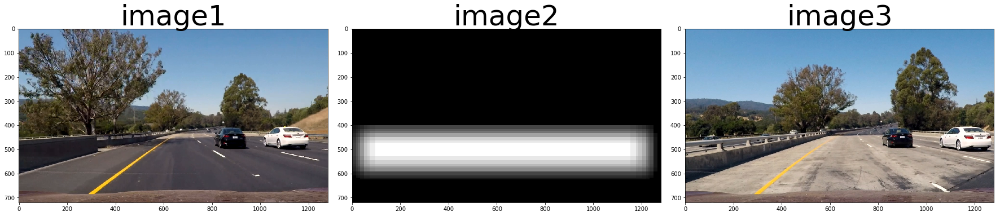

 18%|██████████████▉                                                                    | 7/39 [00:16<01:15,  2.37s/it]

2


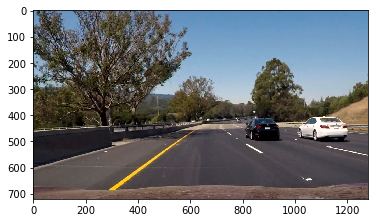

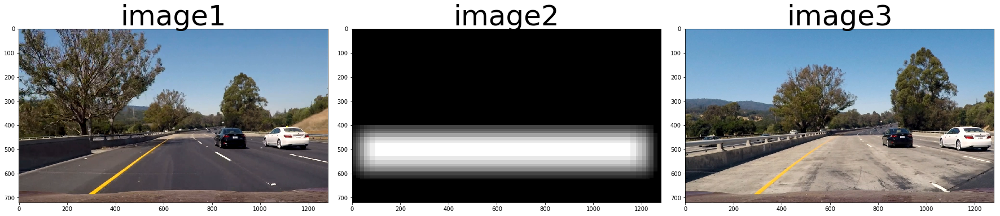

 21%|█████████████████                                                                  | 8/39 [00:19<01:13,  2.36s/it]

2


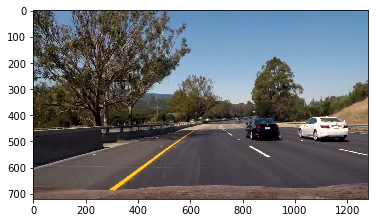

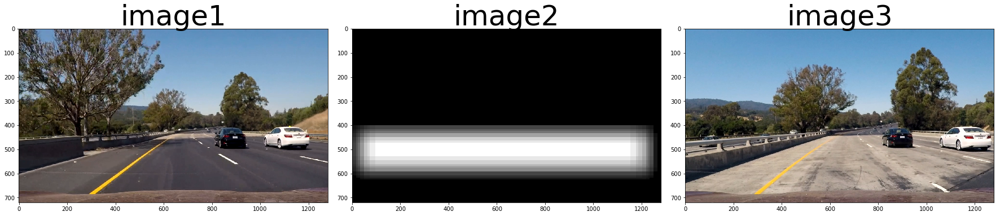

 23%|███████████████████▏                                                               | 9/39 [00:21<01:10,  2.35s/it]

2


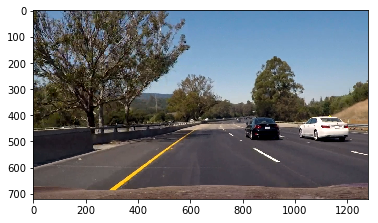

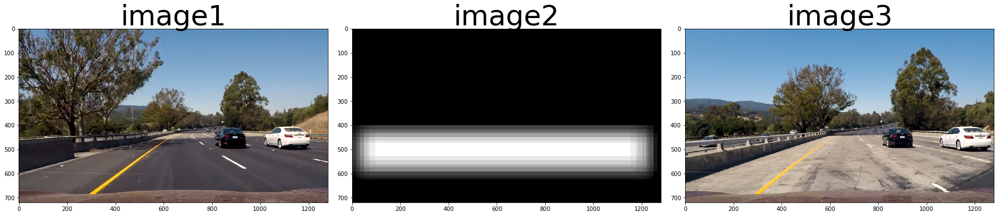

 26%|█████████████████████                                                             | 10/39 [00:23<01:07,  2.34s/it]

2


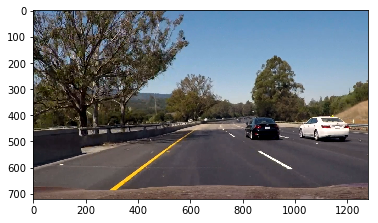

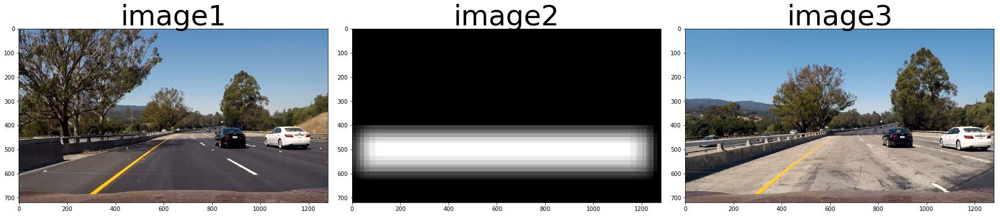

 28%|███████████████████████▏                                                          | 11/39 [00:26<01:05,  2.35s/it]

2


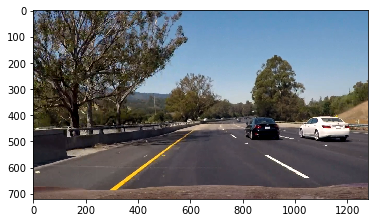

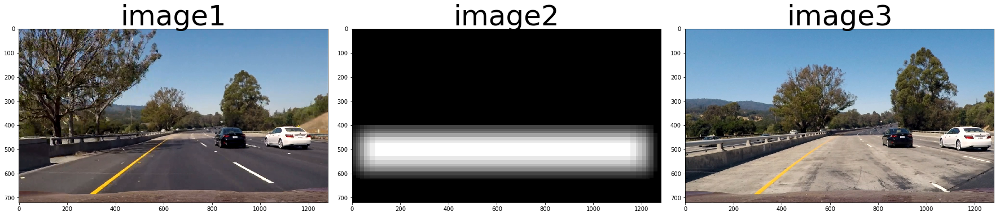

 31%|█████████████████████████▏                                                        | 12/39 [00:28<01:02,  2.31s/it]

2


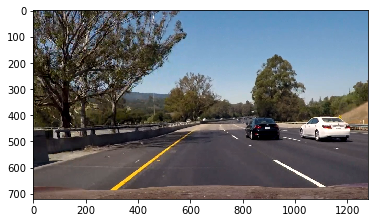

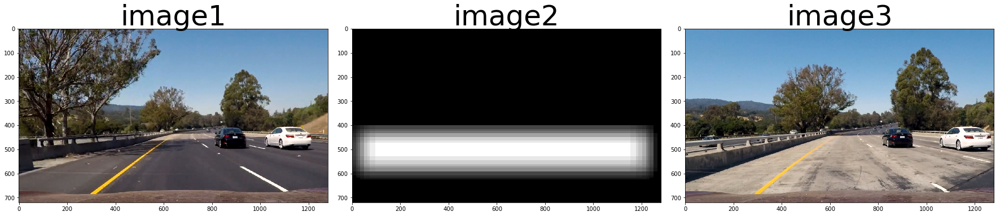

 33%|███████████████████████████▎                                                      | 13/39 [00:30<00:59,  2.30s/it]

2


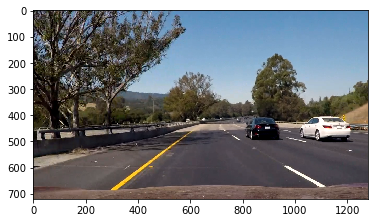

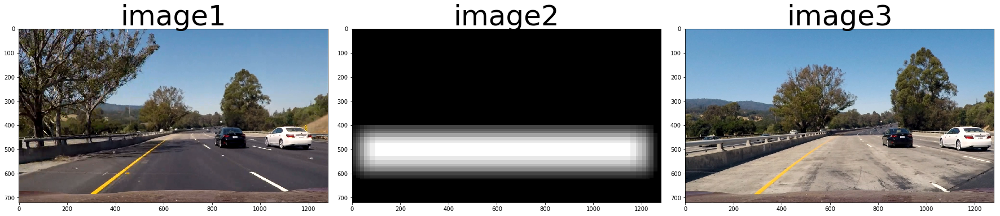

 36%|█████████████████████████████▍                                                    | 14/39 [00:33<00:57,  2.29s/it]

2


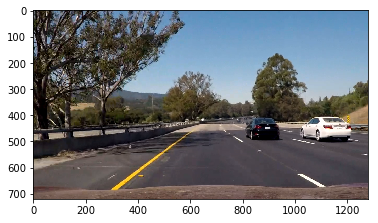

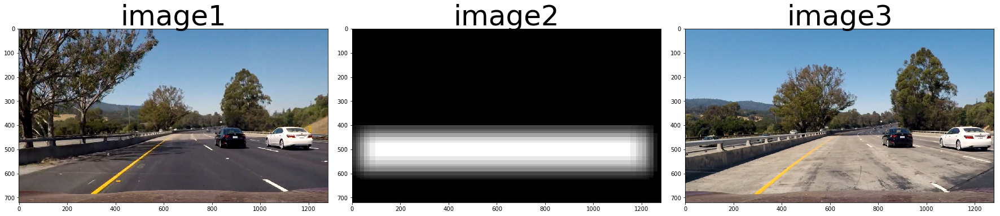

 38%|███████████████████████████████▌                                                  | 15/39 [00:35<00:55,  2.29s/it]

2


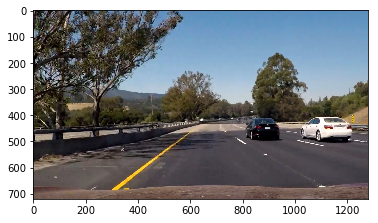

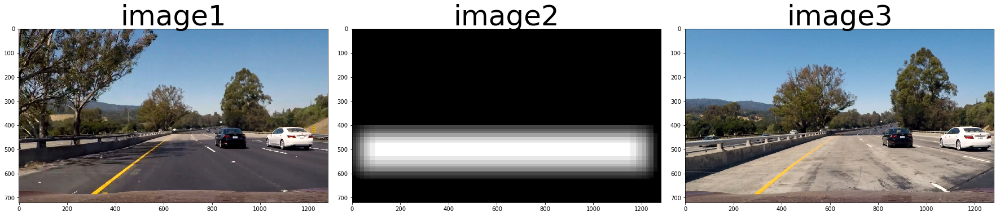

 41%|█████████████████████████████████▋                                                | 16/39 [00:37<00:52,  2.28s/it]

2


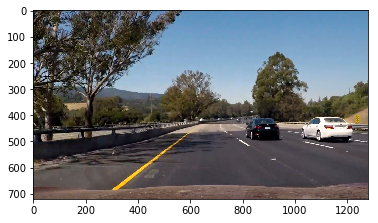

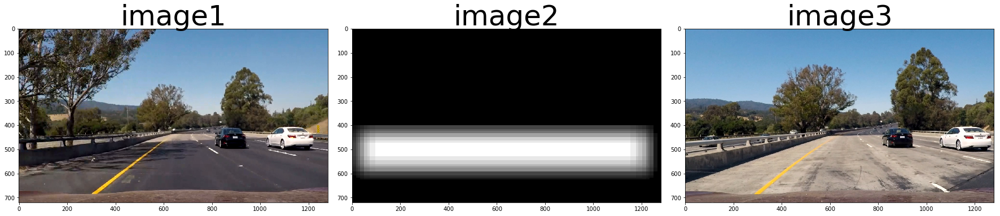

 44%|███████████████████████████████████▋                                              | 17/39 [00:39<00:50,  2.28s/it]

2


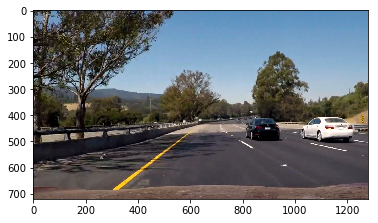

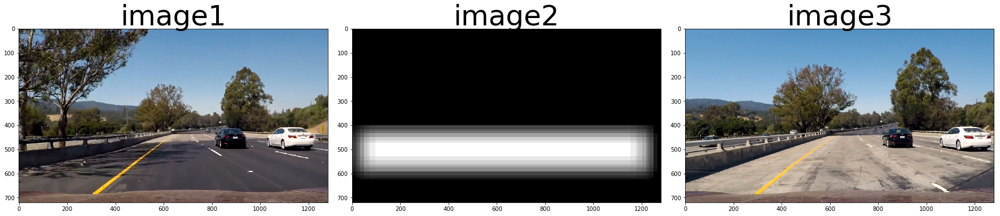

 46%|█████████████████████████████████████▊                                            | 18/39 [00:42<00:47,  2.26s/it]

2


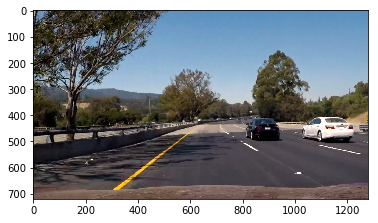

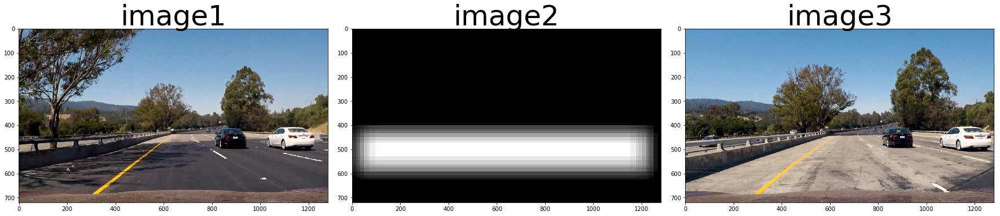

 49%|███████████████████████████████████████▉                                          | 19/39 [00:44<00:45,  2.25s/it]

2


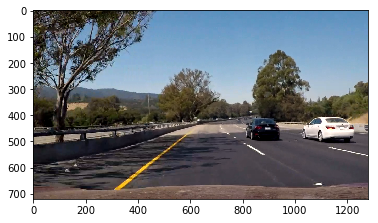

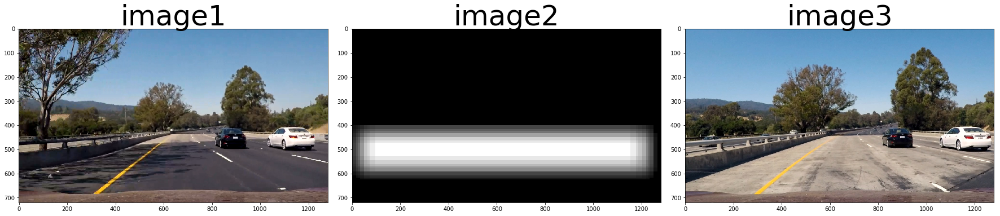

 51%|██████████████████████████████████████████                                        | 20/39 [00:46<00:42,  2.26s/it]

2


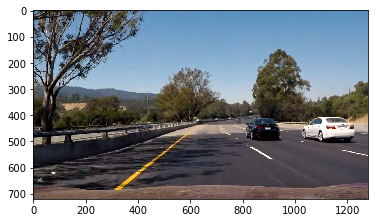

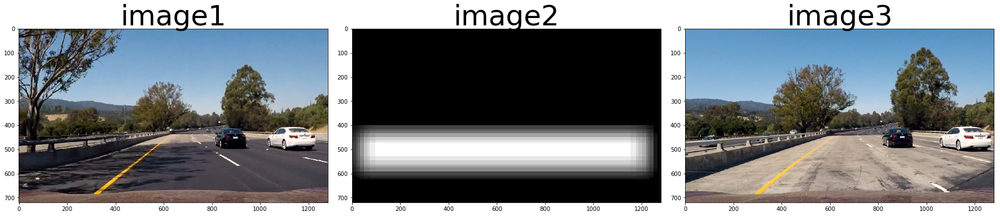

 54%|████████████████████████████████████████████▏                                     | 21/39 [00:48<00:40,  2.25s/it]

2


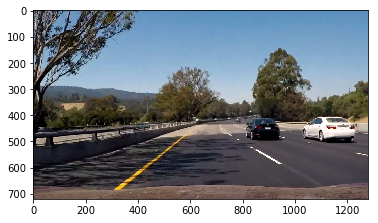

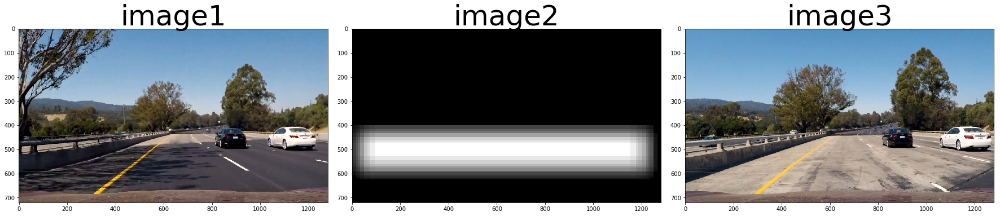

 56%|██████████████████████████████████████████████▎                                   | 22/39 [00:51<00:38,  2.25s/it]

2


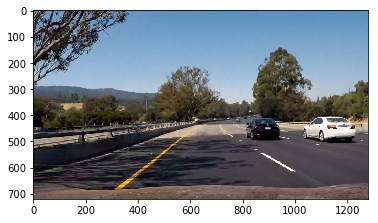

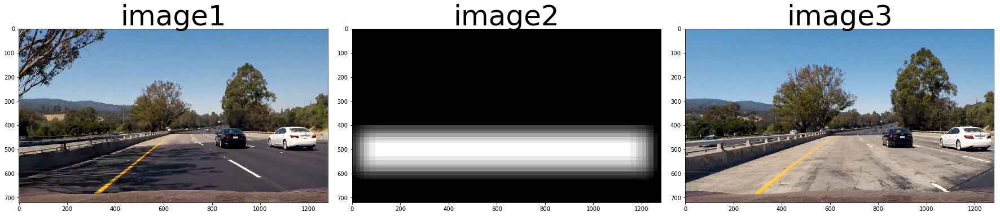

 59%|████████████████████████████████████████████████▎                                 | 23/39 [00:53<00:35,  2.25s/it]

2


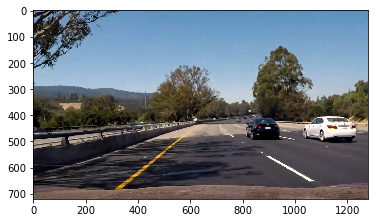

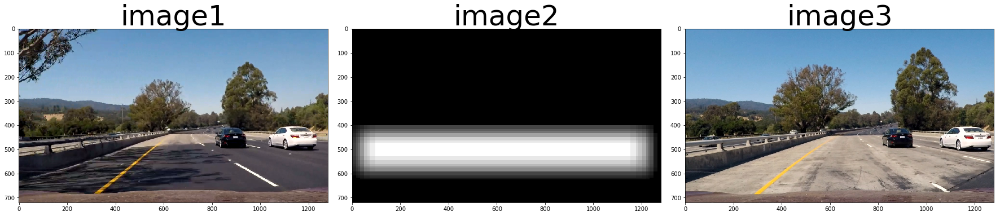

 62%|██████████████████████████████████████████████████▍                               | 24/39 [00:55<00:33,  2.25s/it]

2


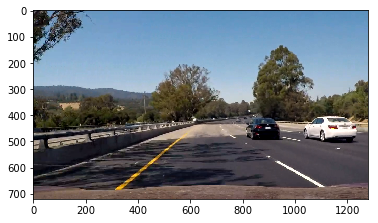

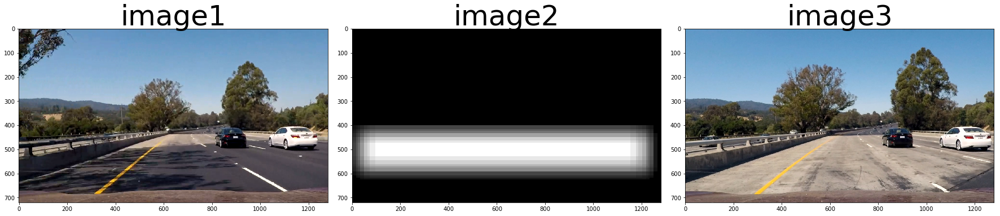

 64%|████████████████████████████████████████████████████▌                             | 25/39 [00:57<00:31,  2.25s/it]

2


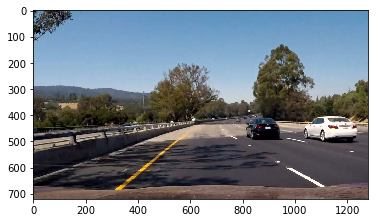

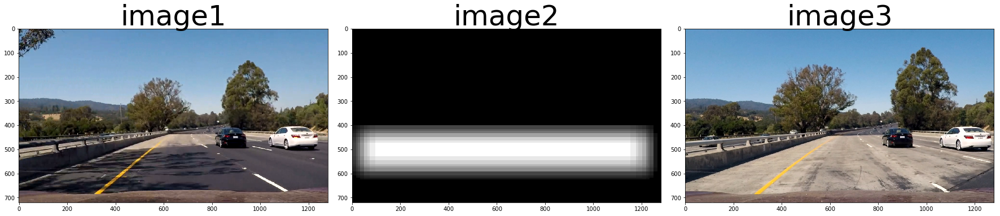

 67%|██████████████████████████████████████████████████████▋                           | 26/39 [01:00<00:29,  2.26s/it]

2


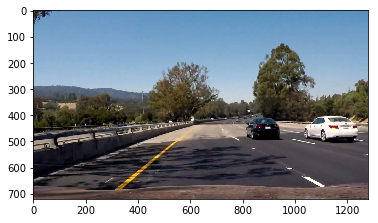

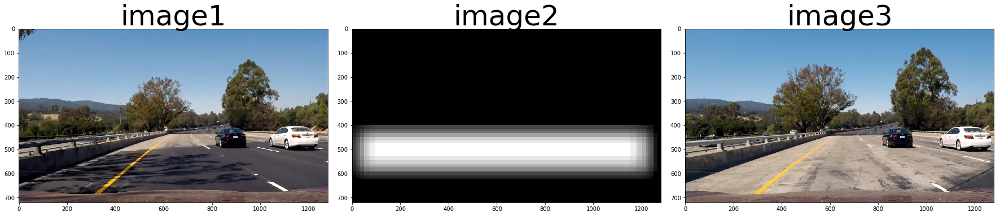

 69%|████████████████████████████████████████████████████████▊                         | 27/39 [01:02<00:27,  2.25s/it]

2


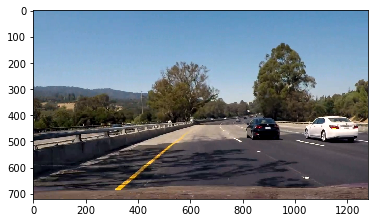

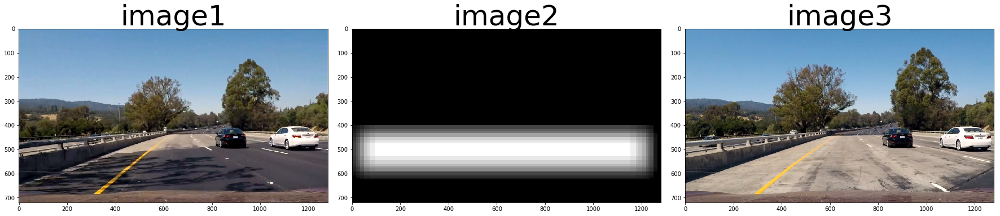

 72%|██████████████████████████████████████████████████████████▊                       | 28/39 [01:04<00:24,  2.25s/it]

2


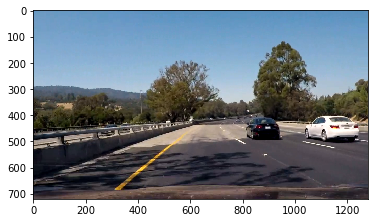

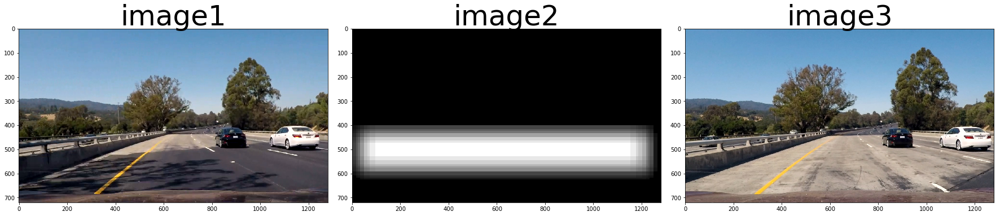

 74%|████████████████████████████████████████████████████████████▉                     | 29/39 [01:06<00:22,  2.26s/it]

2


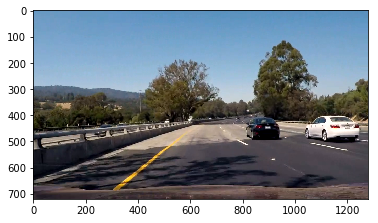

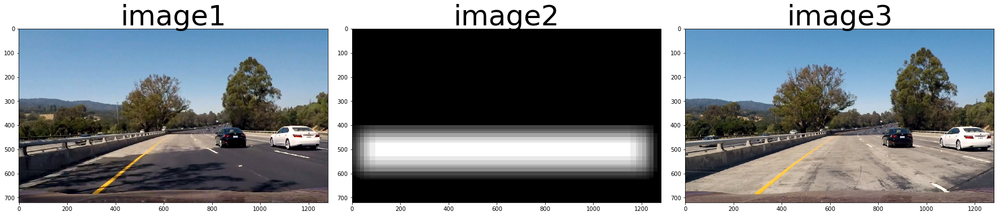

 77%|███████████████████████████████████████████████████████████████                   | 30/39 [01:09<00:20,  2.26s/it]

2


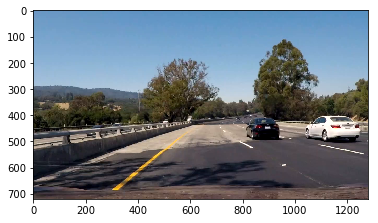

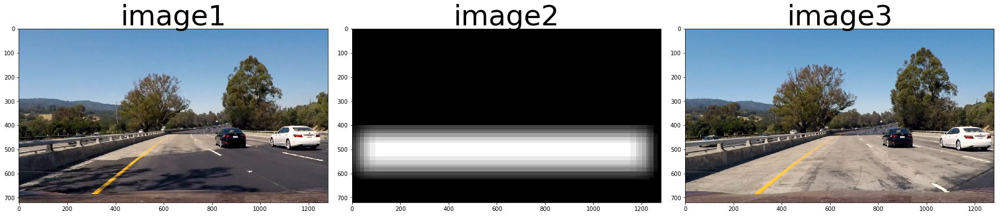

 79%|█████████████████████████████████████████████████████████████████▏                | 31/39 [01:11<00:17,  2.25s/it]

2


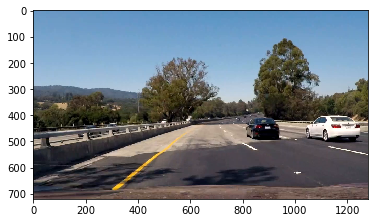

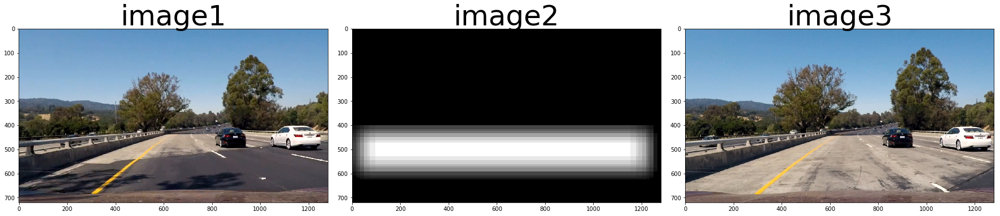

 82%|███████████████████████████████████████████████████████████████████▎              | 32/39 [01:13<00:15,  2.24s/it]

2


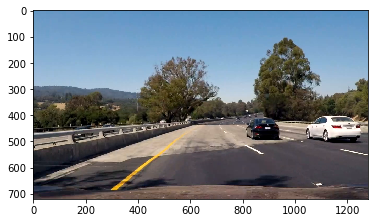

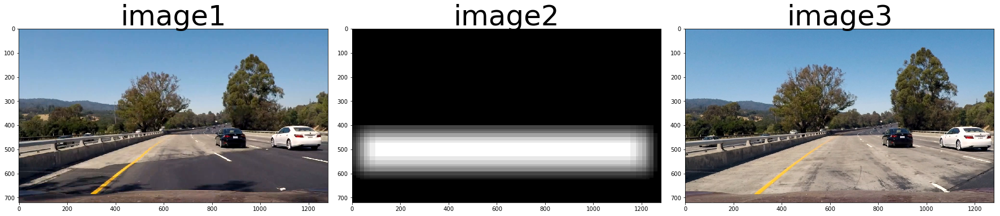

 85%|█████████████████████████████████████████████████████████████████████▍            | 33/39 [01:15<00:13,  2.23s/it]

2


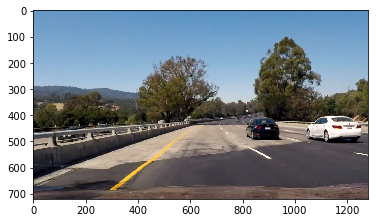

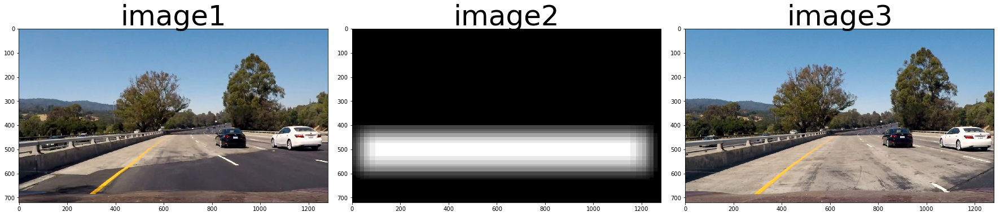

 87%|███████████████████████████████████████████████████████████████████████▍          | 34/39 [01:17<00:11,  2.23s/it]

2


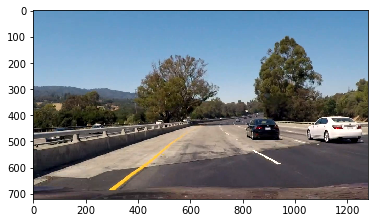

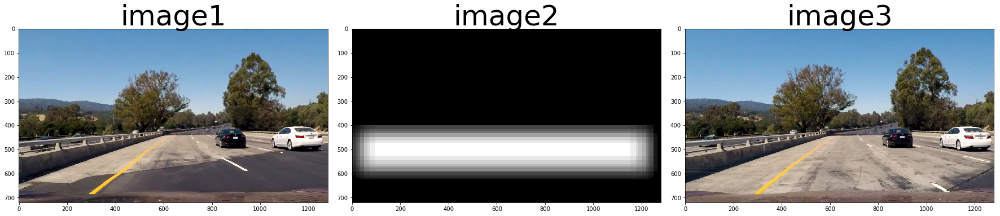

 90%|█████████████████████████████████████████████████████████████████████████▌        | 35/39 [01:20<00:09,  2.26s/it]

2


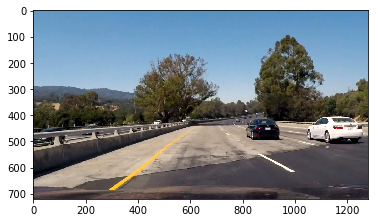

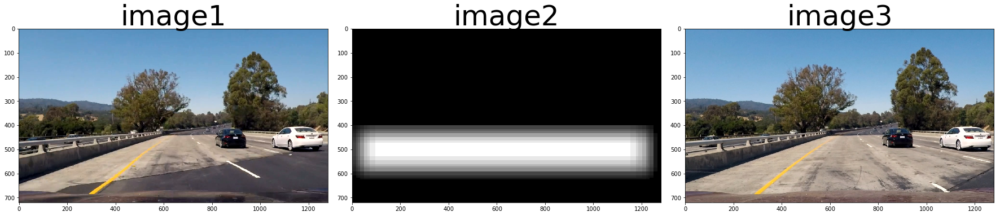

 92%|███████████████████████████████████████████████████████████████████████████▋      | 36/39 [01:22<00:06,  2.26s/it]

2


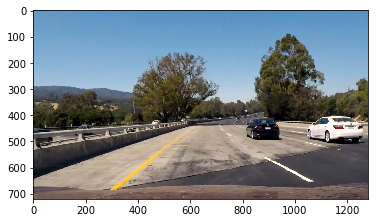

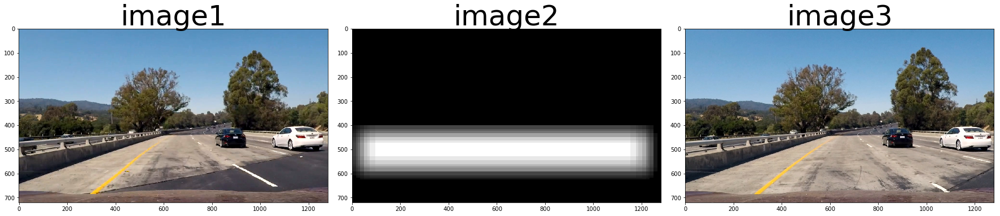

 95%|█████████████████████████████████████████████████████████████████████████████▊    | 37/39 [01:24<00:04,  2.26s/it]

2


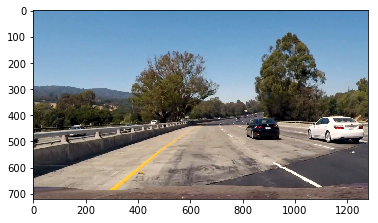

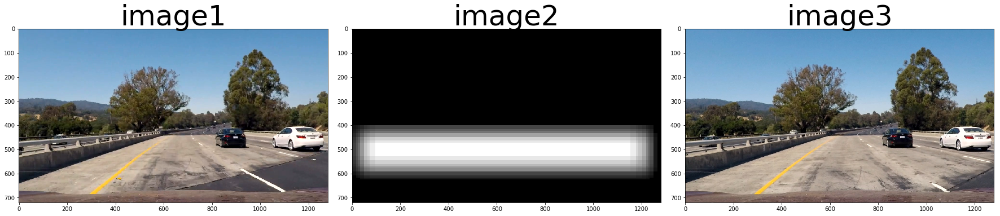

 97%|███████████████████████████████████████████████████████████████████████████████▉  | 38/39 [01:27<00:02,  2.27s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_video_out.mp4 

Wall time: 1min 27s


In [23]:
test_video_res = 'test_video_out.mp4'
test_vid = VideoFileClip('test_video.mp4')
test_video_out = test_vid.fl_image(find_cars_and_draw_box)
%time test_video_out.write_videofile(test_video_res, audio=False)